<a href="https://colab.research.google.com/github/Johsei/Studienarbeit/blob/main/YoloV5_Training_Studienarbeit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Initialisierung

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd /content/drive/MyDrive/Colab Notebooks/Yolo-Training_2

/content/drive/MyDrive/Colab Notebooks/Yolo-Training_2


In [6]:
# YoloV5 Repository Klonen
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 7094, done.
remote: Counting objects: 100% (200/200), done.
remote: Compressing objects: 100% (141/141), done.
remote: Total 7094 (delta 108), reused 113 (delta 59), pack-reused 6894
Receiving objects: 100% (7094/7094), 9.17 MiB | 10.20 MiB/s, done.
Resolving deltas: 100% (4847/4847), done.
/content/drive/My Drive/Colab Notebooks/Yolo-Training_2/yolov5/yolov5


In [7]:
# Von YoloV5 vorgegebene Abhängigkeiten installieren
!pip install -qr requirements.txt
import torch

from IPython.display import Image, clear_output  # Um Bilder anzuzeigen
from utils.google_utils import gdrive_download  # Für Downloads

print('Setup fertig. torch Version %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 645kB 31.7MB/s 
Setup fertig. torch Version 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# Datensatz von Roboflow herunterladen

In [ ]:
# Datensatz von Roboflow herunterladen
%cd ..
!curl -L "https://app.roboflow.com/ds/MW03gEZRNw?key=ol44rKd9m1" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/drive/My Drive/Colab Notebooks/Yolo-Training_Augmented
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1408      0 --:--:-- --:--:-- --:--:--  1408
100  142M  100  142M    0     0  52.4M      0  0:00:02  0:00:02 --:--:-- 75.8M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/000000000113_jpg.rf.a6aca21ad73272ebfdb3eaa06c00284d.jpg  
 extracting: test/images/000000001089_jpg.rf.3342db401a644ce4640d4421839d53f3.jpg  
 extracting: test/images/000000002585_jpg.rf.960f53ef8c54727c8a86e32ca60c9719.jpg  
 extracting: test/images/000000003286_jpg.rf.56c87301159a21253a3e8bbb8b240104.jpg  
 extracting: test/images/000000003595_jpg.rf.8b67c5869b1d18842e3792708891f76b.jpg  
 extracting: test/images/000000003870_jpg.rf.40577cfb524

In [ ]:
# YAML Datei von Roboflow anzeigen
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['cup']

# Konfiguration und Architektur des Modells festlegen


In [ ]:
# Klassen festlegen
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#YoloV5s yaml verwenden
%cat yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [ ]:
#iPython bearbeiten um schreiben zu ermöglichen
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Training


- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# Training mit Zeitmessung
%%time
%cd /content/drive/My Drive/Colab Notebooks/Yolo-Training_Augmented/yolov5
!python train.py --img 416 --batch 32 --epochs 200 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/drive/My Drive/Colab Notebooks/Yolo-Training_Augmented/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-5-13 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=32, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=200, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=32, upload_dataset=False, weights='', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-05-13 12:4

# Performancebewertung mit Tensorboard

In [ ]:
# Start tensorboard
%cd /content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5
%load_ext tensorboard
%tensorboard --logdir runs

/content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1067), started 1:29:16 ago. (Use '!kill 1067' to kill it.)

<IPython.core.display.Javascript object>

### Trainingdaten anzeigen


GROUND TRUTH TRAINING DATA:


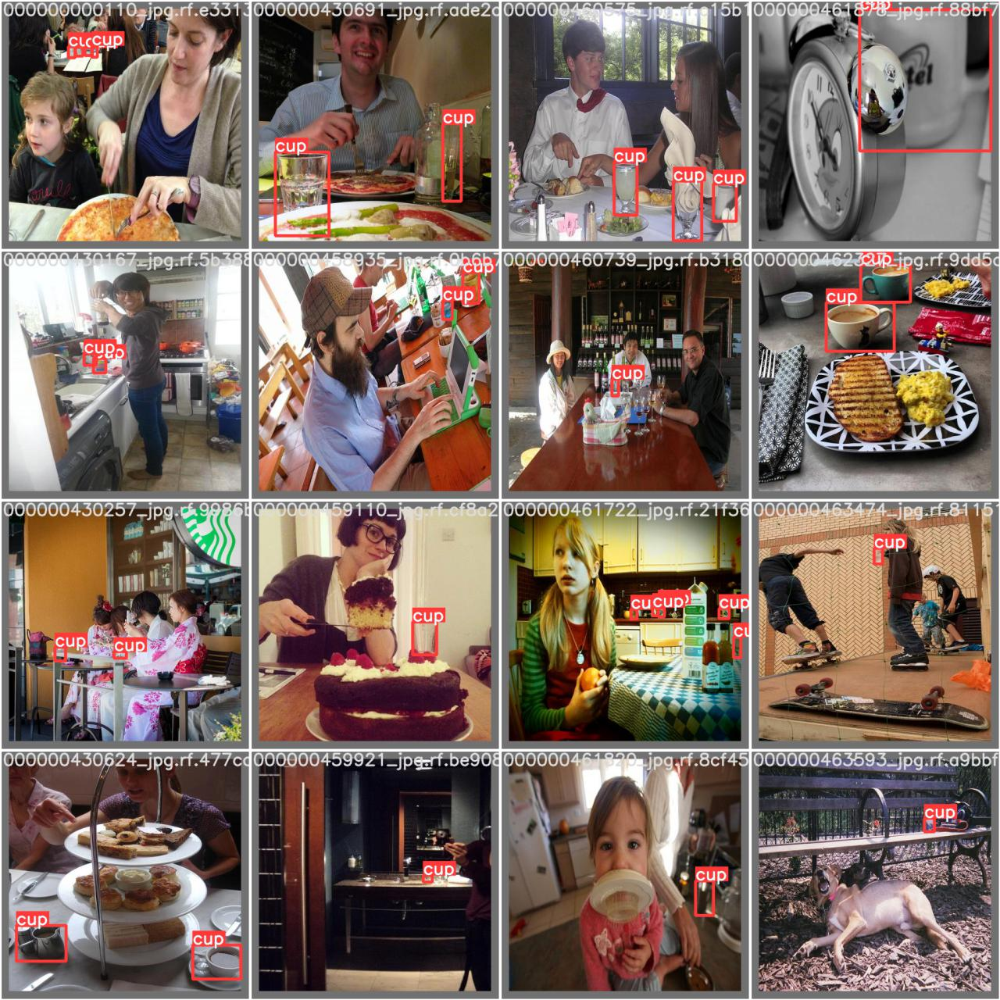

In [ ]:

print("GROUND TRUTH TRAINING DATA:")
Image(filename='runs/train/yolov5s_results2/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


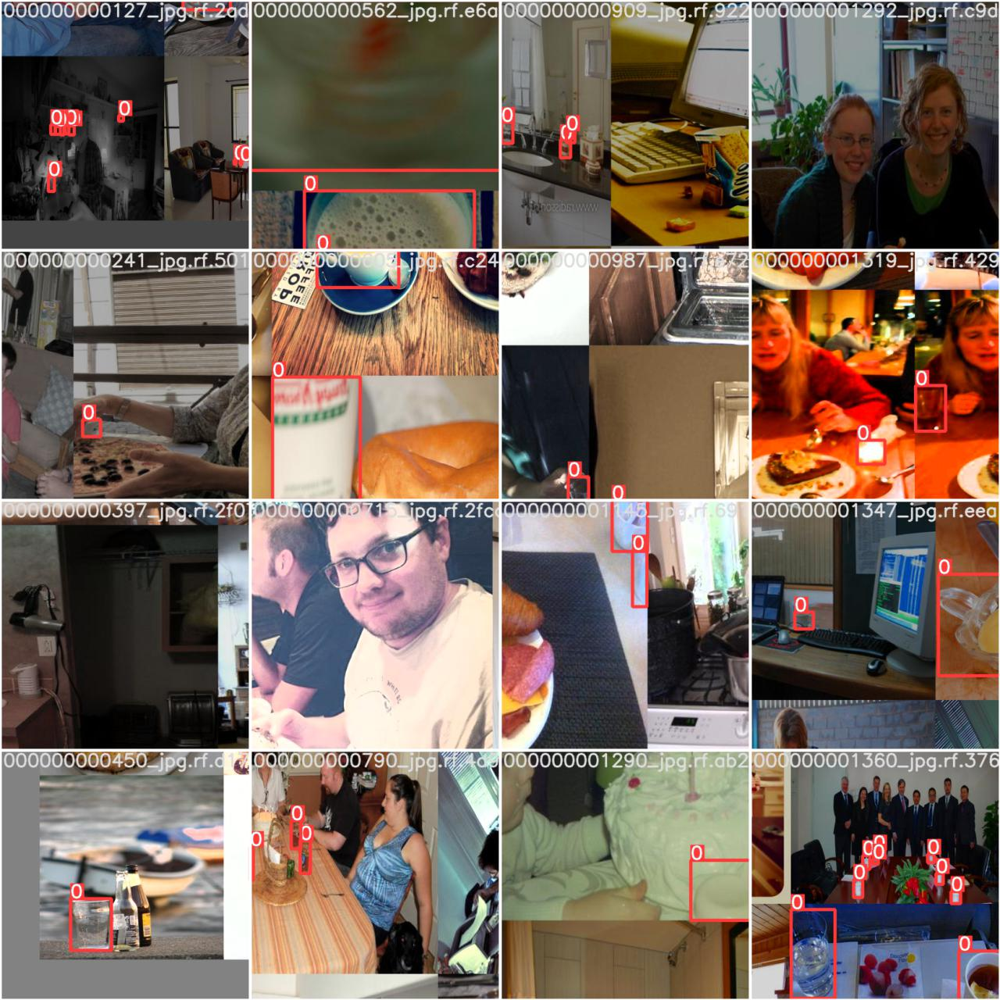

In [ ]:
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='runs/train/yolov5s_results2/train_batch0.jpg', width=900)

#Inferenz

In [ ]:
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results2/weights

ls: cannot access 'runs/train/yolov5s_results2/weights': No such file or directory


In [ ]:
%cd /content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5/
!python detect.py --weights runs/train/yolov5s_results2/weights/best.pt --img 416 --conf 0.4 --source ../test/img2.jpg

/content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=416, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='../test/img2.jpg', update=False, view_img=False, weights=['runs/train/yolov5s_results2/weights/best.pt'])
YOLOv5 🚀 2021-5-13 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPS
image 1/1 /content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5/../test/img2.jpg: 320x416 1 cup, Done. (0.010s)
Results saved to runs/detect/exp5
Done. (0.329s)


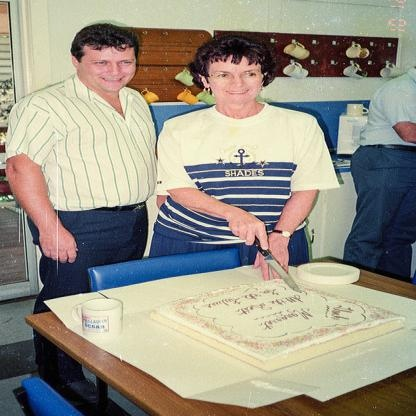

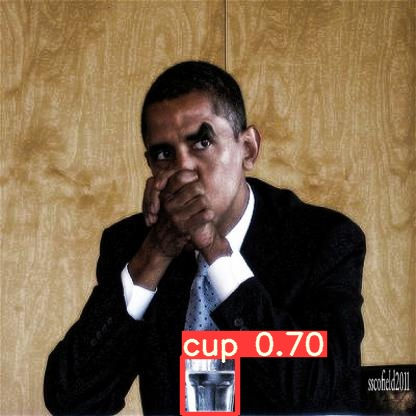

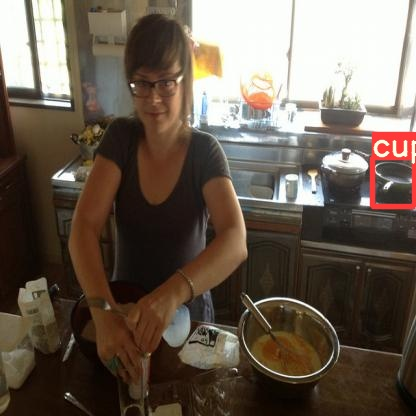

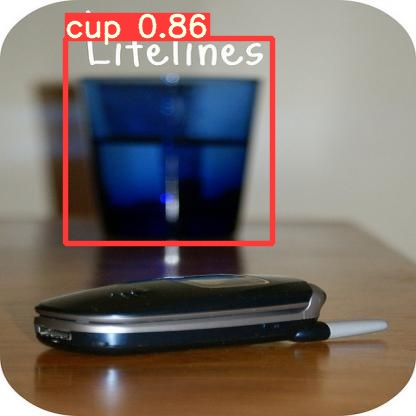

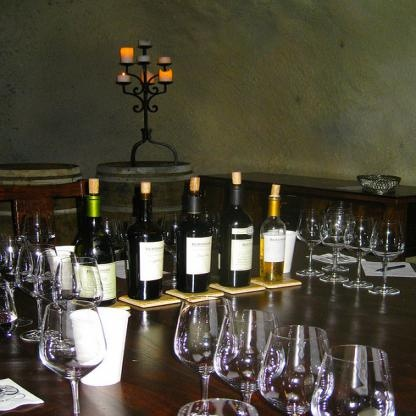

...

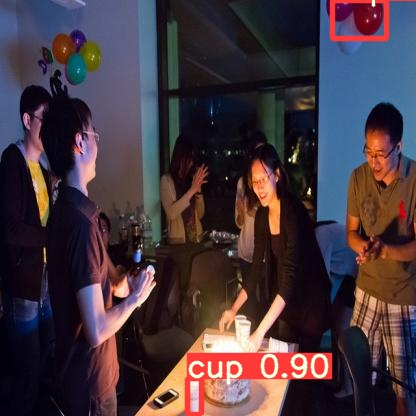

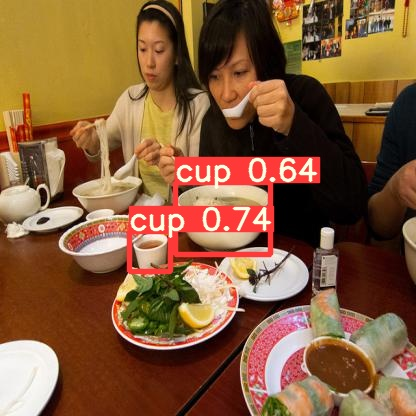

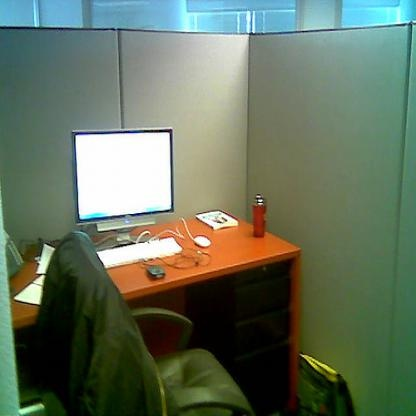

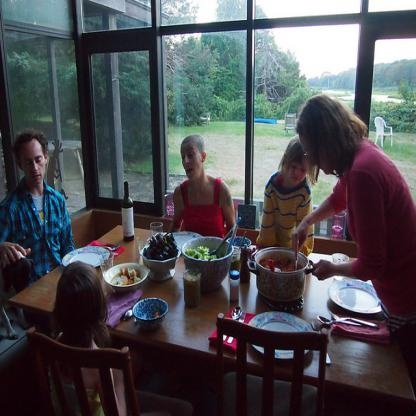

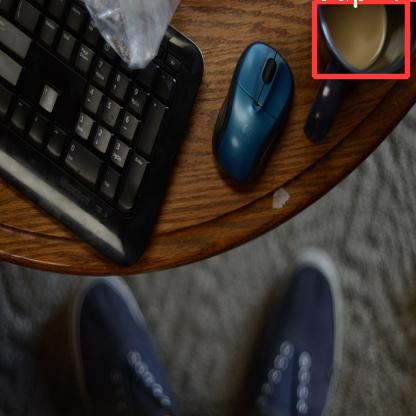

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/My Drive/Colab Notebooks/Yolo-Training/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")